# Elecciones de Puebla 2019
#### Un analisis y visualizacion geografica de las elecciones de Junio 2019 en Puebla, Mexico.

<details>
    <summary><strong>Meta</strong></summary>
    La meta de este notebook es crear un mapa interactivo utilizando los datos de las elecciones de puebla en junio 2019.
    <ul>
        <li> Metas mensurables </li>
        <li> Identificar variables de interes en el conjunto de datos que @YaNiPaper limpió.</li>
        <li> Crear un mapa como el que @palewire publicó en twitter: https://twitter.com/palewire/status/1137815979780476928</li>
    </ul>
</details>

<details>
    <summary><strong>Contexto</strong></summary>
    @YaNiPaper limpió los datos y creo mapas (que se encuentran en el directorio: <code style="background-color:#eee">reportes/figuras/</code>.
    <li> Lo que queremos hacer es recrear el mapa de @palewire con datos de puebla.</li>
</details>

In [3]:
import pandas as pd
from zipfile import ZipFile
from pathlib import Path
from herramientas import arbol
import arrow
import altair as alt
import geopandas as gpd
import gpdvega

hoy = arrow.now('local').format(fmt = 'DD-MMM-YY', locale = 'es')

hoy

'10-jun-19'

In [12]:
%matplotlib inline

In [4]:
DATOS_BRUTOS = Path("../datos/brutos/")
DATOS_INTERINOS = Path("../datos/interinos/")
DATOS_PROCESADOS = Path("../datos/procesados/")
DATOS_EXTERNOS = Path("../datos/externos/")

In [5]:
arbol(DATOS_BRUTOS)

+ ..\datos\brutos
    + 21_CATALOGO_SECCIONES.xlsx
    + 21_CATALOGO_SECCIONESa.csv
    + municipios
        + MUNICIPIOS.dbf
        + MUNICIPIOS.prj
        + MUNICIPIOS.shp
        + MUNICIPIOS.shx
    + PUE_GUB_ext_2019a.csv
    + PUE_GUB_ext_2019b.xlsx


In [17]:
arbol(DATOS_EXTERNOS)

+ ..\datos\externos
    + elecciones_pueba_2019.csv
    + elecciones_pueba_por_municipio_2019.csv


In [19]:
datos_por_municipio = pd.read_csv(DATOS_EXTERNOS / 'elecciones_pueba_por_municipio_2019.csv')

datos_por_municipio.head()

,MUNICIPIO,ENRIQUE_CARDENAS_SANCHEZ,ALBERTO_JIMENEZ_MERINO,MIGUEL_BARBOSA_HUERTA,NO_REGISTRADOS,NULOS,TOTAL_VOTOS,LISTA_NOMINAL,ecs_porc,ajm_porc,mbh_porc,no_reg_porc,nulos_porc,abst_porc,GANADOR,PORC_GANADOR,CVE_GANADOR
0,1,2918,3733,3689,6,295,10641,45097,27.42,35.08,34.67,0.06,2.77,23.60,ALBERTO_JIMENEZ_MERINO,35.08,3
1,2,224,502,2285,4,90,3105,6978,7.21,16.17,73.59,0.13,2.90,44.50,MIGUEL_BARBOSA_HUERTA,73.59,1
2,3,1207,1671,4272,7,203,7360,27749,16.40,22.70,58.04,0.10,2.76,26.52,MIGUEL_BARBOSA_HUERTA,58.04,1
3,4,2866,2512,3229,22,221,8850,37475,32.38,28.38,36.49,0.25,2.50,23.62,MIGUEL_BARBOSA_HUERTA,36.49,1
4,5,98,282,729,0,54,1163,2333,8.43,24.25,62.68,0.00,4.64,49.85,MIGUEL_BARBOSA_HUERTA,62.68,1


In [7]:
municipios = gpd.read_file(DATOS_BRUTOS / 'municipios' / 'MUNICIPIOS.shp')

In [11]:
municipios.head()

,CVE_ENT,CVE_MUN,NOM_MUN,geometry
0,17,001,Amacuzac,POLYGON ((-99.41078063099997 18.65485693800002...
1,17,002,Atlatlahucan,POLYGON ((-98.85733335399999 18.97459190800004...
2,17,003,Axochiapan,POLYGON ((-98.72374586199999 18.60630169200005...
3,17,004,Ayala,POLYGON ((-99.01148816899996 18.81019836900003...
4,17,005,Coatlán del Río,POLYGON ((-99.42058272299994 18.80154069200006...


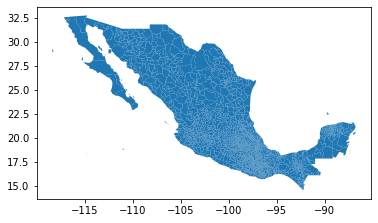

In [13]:
municipios.plot();

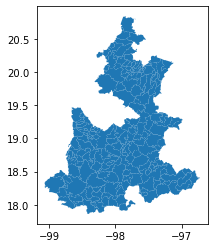

In [15]:
mascara_puebla = municipios['CVE_ENT'] == '21'
puebla = municipios[mascara_puebla].copy()

puebla.plot();

In [20]:
puebla.head()

,CVE_ENT,CVE_MUN,NOM_MUN,geometry
674,21,027,Caltepec,(POLYGON ((-97.63455949181252 18.1869593849378...
675,21,072,Huehuetla,(POLYGON ((-97.60621935417856 20.0549752772453...
676,21,073,Huehuetlán el Chico,(POLYGON ((-98.7634613231296 18.28963013839267...
677,21,088,Jonotla,(POLYGON ((-97.54922098501468 20.0684811539894...
678,21,155,Tecomatlán,(POLYGON ((-98.26744281477595 17.9599673234448...


In [23]:
puebla.shape

(217, 4)

In [24]:
datos_por_municipio['CVE_MUN'] = datos_por_municipio['MUNICIPIO'].astype(str).str.zfill(3)

In [26]:
puebla_con_datos = puebla.merge(datos_por_municipio)

In [27]:
puebla_con_datos.head(2).T

,0,1
CVE_ENT,21,21
CVE_MUN,027,072
NOM_MUN,Caltepec,Huehuetla
geometry,(POLYGON ((-97.63455949181252 18.1869593849378...,(POLYGON ((-97.60621935417856 20.0549752772453...
MUNICIPIO,27,72
ENRIQUE_CARDENAS_SANCHEZ,508,4167
ALBERTO_JIMENEZ_MERINO,418,4575
MIGUEL_BARBOSA_HUERTA,789,11390
NO_REGISTRADOS,0,28
NULOS,38,1195


In [40]:
puebla_con_datos = puebla_con_datos.rename(columns = {
    "ENRIQUE_CARDENAS_SANCHEZ": "Enrique Cárdenas Sánchez",
    "ALBERTO_JIMENEZ_MERINO": "Alberto Jiménez Merino",
    "MIGUEL_BARBOSA_HUERTA": "Miguel Barbosa Huerta",
    "NO_REGISTRADOS": "No registrados",
    "NULOS": "Votos nulos",
    "TOTAL_VOTOS": "Total de votos",
    "GANADOR": "Ganador",
    "PORC_GANADOR": "% del ganador"
})

In [54]:
puebla_con_datos['Ganador'] = puebla_con_datos['Ganador'].str.replace("_", ' ').str.title()

In [60]:
# centroides
puebla_con_datos['centroide_x'] = puebla_con_datos['geometry'].centroid.x
puebla_con_datos['centroide_y'] = puebla_con_datos['geometry'].centroid.y

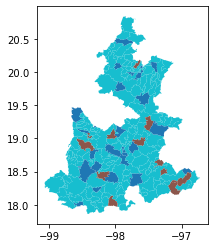

In [61]:
puebla_con_datos.plot(column = 'Ganador');

## palewire's

In [62]:
base = alt.Chart(puebla_con_datos).mark_geoshape(
    stroke='black',
    strokeWidth=0.1
).encode().properties(
    width=600,
    height=800
)

In [63]:
geoshape = alt.Chart(puebla_con_datos).mark_geoshape(
    fill='lightgray',
    stroke='black'
)

In [64]:
outcome = geoshape.encode(
    color=alt.Color(
        "Ganador:N",
        title="Ganador"
    ),
    tooltip = ['Enrique Cárdenas Sánchez', 'Alberto Jiménez Merino', 'Miguel Barbosa Huerta', 'Votos nulos', 'Total de votos', 'Ganador', '% del ganador']
)

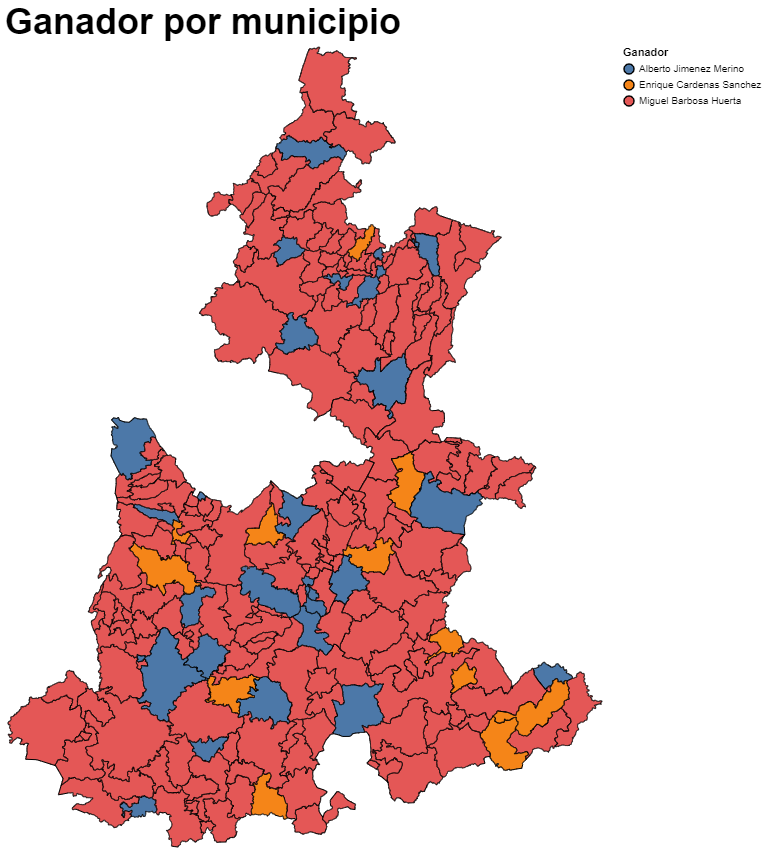

In [67]:
ganador_por_municipio = (base + outcome).properties(title="Ganador por municipio", ).configure_view(
    strokeWidth=0,
).configure_title(fontSize = 36, align = 'left', anchor = 'start')

ganador_por_municipio

## palewire 2

In [78]:
turnout = alt.Chart(puebla_con_datos).mark_circle().encode(
    longitude='centroide_x:Q',
    latitude='centroide_y:Q',
    size=alt.Size(
        "Total de votos:Q",
        title="Total de votos",
    
    ),
    color = alt.Color('Ganador:N'),
    tooltip = ['Enrique Cárdenas Sánchez', 'Alberto Jiménez Merino', 'Miguel Barbosa Huerta', 'Votos nulos', 'Total de votos', 'Ganador', '% del ganador']
)

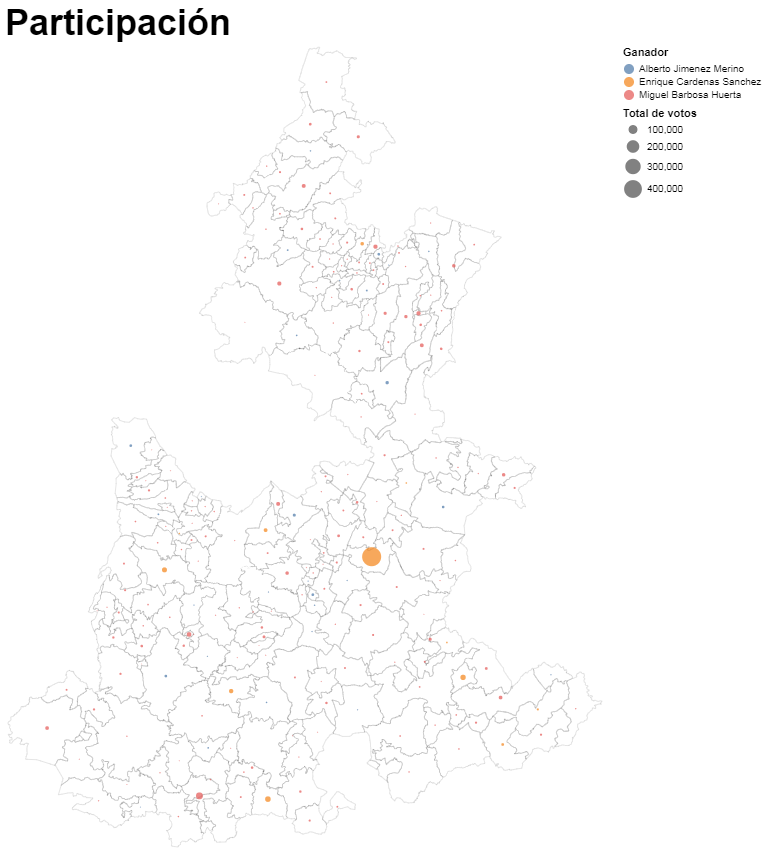

In [79]:
participacion = (base + turnout).properties(title="Participación").configure_view(
    strokeWidth=0
).configure_title(fontSize = 36, align = 'left', anchor = 'start')

participacion